In [1]:
import pandas as pd
import torch
import numpy as np
import torch.nn as nn
from torch.nn.utils.rnn import pad_sequence
from sklearn.model_selection import KFold
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
from torch.utils.data import Sampler

df = pd.read_csv("../data/csr_embeddings_leq2019_filled_citation_count.csv")
company_ids = df['ticker'].unique()
kf = KFold(n_splits=5, shuffle=True, random_state=42)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

folds = []
for train_idx, test_idx in kf.split(company_ids):
    train_companies = company_ids[train_idx]
    test_companies = company_ids[test_idx]
    folds.append((train_companies, test_companies))

In [2]:
df

,file_name,dim_0,dim_1,dim_2,dim_3,dim_4,dim_5,dim_6,dim_7,dim_8,...,dim_1018,dim_1019,dim_1020,dim_1021,dim_1022,dim_1023,ticker,year,total_5yr_forward_citations,patents_count
0,NASDAQ_AAPL_2014,-0.091830,0.293040,-0.179719,0.083607,-0.032453,0.012720,-0.027948,0.030055,0.105388,...,0.290067,-0.223406,-0.325722,0.009091,-0.170071,0.163041,AAPL,2014,665.0,91.0
1,NASDAQ_AAPL_2015,-0.085034,0.276596,-0.139275,0.068203,-0.015527,-0.055515,-0.033100,0.032737,0.124428,...,0.292318,-0.212523,-0.331629,-0.030166,-0.150414,0.180043,AAPL,2015,680.0,105.0
2,NASDAQ_AAPL_2016,-0.067159,0.277524,-0.148442,0.092723,-0.000616,-0.040362,-0.032554,0.009260,0.143966,...,0.296767,-0.216122,-0.327691,-0.037364,-0.151454,0.178229,AAPL,2016,498.0,85.0
3,NASDAQ_AAPL_2017,-0.053141,0.259755,-0.160064,0.098964,-0.006857,-0.001506,-0.052370,0.012755,0.146752,...,0.284501,-0.213012,-0.317366,-0.034005,-0.147262,0.175490,AAPL,2017,463.0,54.0
4,NASDAQ_AAPL_2018,-0.070878,0.338528,-0.095608,0.093072,-0.027314,-0.033892,-0.052765,0.021670,0.055076,...,0.274357,-0.190008,-0.347579,-0.004540,-0.125971,0.124562,AAPL,2018,71.0,19.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1013,NYSE_WMT_2019,-0.027768,0.268011,-0.044915,-0.037989,-0.029441,0.107877,-0.119624,0.021277,0.127110,...,0.378803,-0.198541,-0.265622,-0.057896,-0.136153,0.116260,WMT,2019,0.0,0.0
1014,NYSE_XRX_2016,-0.094249,0.258920,-0.112034,-0.031890,-0.040051,0.081830,-0.113565,-0.021055,0.120458,...,0.330996,-0.078453,-0.269516,0.010672,-0.152912,0.172861,XRX,2016,7.0,3.0
1015,NYSE_XRX_2017,-0.116771,0.273073,0.085469,-0.172837,-0.261041,-0.295415,-0.034079,0.221862,0.033038,...,0.342520,-0.213148,-0.552106,-0.062122,-0.010183,0.144048,XRX,2017,0.0,0.0
1016,NYSE_XRX_2018,-0.120495,0.256214,-0.124283,-0.008754,-0.040228,0.083673,-0.134553,-0.033440,0.127288,...,0.347586,-0.078939,-0.259030,0.024605,-0.203625,0.167591,XRX,2018,0.0,0.0


In [3]:
class SlidingWindowDatasetMax5(torch.utils.data.Dataset):
    def __init__(self, df, company_list, max_len=5):
        self.samples = []

        df = df[df['ticker'].isin(company_list)].copy()

        for company_id, group in df.groupby('ticker'):
            group = group.sort_values('year').reset_index(drop=True)

            years = group['year'].values
            x_all = torch.tensor(group[[f'dim_{i}' for i in range(1024)]].values, dtype=torch.float32)
            y_all = torch.tensor(group[['patents_count', 'total_5yr_forward_citations']].values, dtype=torch.float32)
            y_all = torch.log1p(y_all)

            for end in range(len(group)):
                start = max(0, end - max_len + 1)  # 讓長度不超過 max_len
                x_seq = x_all[start:end+1]
                y_seq = y_all[end]
                y_year = years[end]
                self.samples.append({
                    'x_seq': x_seq,
                    'y_seq': y_seq,
                    'ticker': company_id,
                    'y_year': y_year,
                    'index': f"{company_id}_{years[start]}_{y_year}"
                })

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        sample = self.samples[idx]
        return sample['x_seq'], sample['y_seq'], sample['ticker'], sample['y_year'], sample['index']


In [4]:
class CompanyBatchSampler(Sampler):
    def __init__(self, dataset):
        self.dataset = dataset
        self.company_to_indices = {}
        for idx, sample in enumerate(dataset.samples):
            company = sample['ticker']
            if company not in self.company_to_indices:
                self.company_to_indices[company] = []
            self.company_to_indices[company].append(idx)
        self.companies = list(self.company_to_indices.keys())

    def __iter__(self):
        np.random.shuffle(self.companies)
        for company in self.companies:
            yield self.company_to_indices[company]

    def __len__(self):
        return len(self.companies)

In [5]:
class LSTM_MTL_Stepwise(nn.Module):
    def __init__(self, input_dim=1024, hidden_dim=256, head_dim=32):
        super().__init__()
        self.lstm_cell = nn.LSTMCell(input_dim, hidden_dim)
        
        # Head for patents_count
        self.head_count = nn.Sequential(
            nn.Linear(hidden_dim, head_dim),
            nn.ReLU(),
            nn.Linear(head_dim, 1),
            nn.ReLU()
        )
        
        # Head for citations
        self.head_citation = nn.Sequential(
            nn.Linear(hidden_dim, head_dim),
            nn.ReLU(),
            nn.Linear(head_dim, 1),
            nn.ReLU()
        )

    def forward(self, x, lengths):  
        B, T_max, D = x.shape
        
        h = torch.zeros(B, 256, device=x.device)
        c = torch.zeros(B, 256, device=x.device)
        
        # 逐步累積所有時間步的 h，最後根據每筆資料的真實長度從 h_all 中動態取出對應的最後有效 h（而非直接取 T_max），避免 padding 影響
        h_list = []

        for t in range(T_max):
            h, c = self.lstm_cell(x[:, t, :], (h, c))
            h_list.append(h.unsqueeze(1))  # [B, 1, H]

        h_all = torch.cat(h_list, dim=1)  # [B, T_max, H]

        # 使用 batch 索引直接取出每筆資料最後有效步驟的 h
        batch_indices = torch.arange(B, device=x.device)
        last_h = h_all[batch_indices, lengths - 1, :]  # [B, H]

        y1 = self.head_count(last_h)
        y2 = self.head_citation(last_h)

        return torch.cat([y1, y2], dim=1)  # [B, 2]

In [6]:
# --- Metrics (expm1 to reverse log1p) ---
def compute_metrics(y_pred, y_true):
    y_pred = torch.expm1(y_pred).cpu().numpy()
    y_true = torch.expm1(y_true).cpu().numpy()
    metrics = {}

    # 加上 round
    y_pred = np.round(y_pred)
    y_true = np.round(y_true)
    
    for i, name in enumerate(["count", "citation"]):
        y_p, y_t = y_pred[:, i], y_true[:, i]
        mse = np.mean((y_p - y_t) ** 2)
        mae = np.mean(np.abs(y_p - y_t))
        rmse = np.sqrt(mse)
        smape = np.mean(2 * np.abs(y_p - y_t) / (np.abs(y_p) + np.abs(y_t) + 1e-8))*100
        metrics[name] = {"MSE": mse, "MAE": mae, "RMSE": rmse, "SMAPE": smape}
    return metrics

In [7]:
def inspect_folds_and_epochs(df, folds, epochs=3):
    for fold_id, (train_coms, test_coms) in enumerate(folds):
        print(f"\n====== Inspect Fold {fold_id+1} ======")

        # Dataset   
        train_dataset = SlidingWindowDatasetMax5(df, train_coms)
        test_dataset = SlidingWindowDatasetMax5(df, test_coms)

        # Sampler
        train_sampler = CompanyBatchSampler(train_dataset)
        val_sampler = CompanyBatchSampler(test_dataset)

        # DataLoader
        train_loader = DataLoader(train_dataset, batch_sampler=train_sampler, collate_fn=lambda x: x)
        val_loader = DataLoader(test_dataset, batch_sampler=val_sampler, collate_fn=lambda x: x)

        for epoch in range(epochs):
            print(f"\n--- Fold {fold_id+1} Epoch {epoch+1} [Train] ---")
            company_counter = 0
            sample_counter = 0
            for batch in train_loader:
                _, _, tickers, y_years, indices = zip(*batch)
                print(f"Company: {tickers[0]} | Samples: {len(indices)} | Years: {min(y_years)}-{max(y_years)}")
                print(f"  Indices: {indices}")
                company_counter += 1
                sample_counter += len(indices)
            print(f"===> [Train Summary] Companies: {company_counter} | Total Samples: {sample_counter}")

            print(f"\n--- Fold {fold_id+1} Epoch {epoch+1} [Validation] ---")
            company_counter = 0
            sample_counter = 0
            for batch in val_loader:
                _, _, tickers, y_years, indices = zip(*batch)
                print(f"Company: {tickers[0]} | Samples: {len(indices)} | Years: {min(y_years)}-{max(y_years)}")
                print(f"  Indices: {indices}")
                company_counter += 1
                sample_counter += len(indices)
            print(f"===> [Validation Summary] Companies: {company_counter} | Total Samples: {sample_counter}")


In [8]:
inspect_folds_and_epochs(df, folds, epochs=3)


====== Inspect Fold 1 ======

--- Fold 1 Epoch 1 [Train] ---
Company: CIEN | Samples: 1 | Years: 2018-2018
  Indices: ('CIEN_2018_2018',)
Company: SPB | Samples: 1 | Years: 2017-2017
  Indices: ('SPB_2017_2017',)
Company: MMM | Samples: 9 | Years: 2011-2019
  Indices: ('MMM_2011_2011', 'MMM_2011_2012', 'MMM_2011_2013', 'MMM_2011_2014', 'MMM_2011_2015', 'MMM_2012_2016', 'MMM_2013_2017', 'MMM_2014_2018', 'MMM_2015_2019')
Company: INTC | Samples: 10 | Years: 2006-2016
  Indices: ('INTC_2006_2006', 'INTC_2006_2007', 'INTC_2006_2008', 'INTC_2006_2009', 'INTC_2006_2010', 'INTC_2007_2011', 'INTC_2008_2012', 'INTC_2009_2013', 'INTC_2010_2015', 'INTC_2011_2016')
Company: MHK | Samples: 4 | Years: 2016-2019
  Indices: ('MHK_2016_2016', 'MHK_2016_2017', 'MHK_2016_2018', 'MHK_2016_2019')
Company: REGN | Samples: 3 | Years: 2017-2019
  Indices: ('REGN_2017_2017', 'REGN_2017_2018', 'REGN_2017_2019')
Company: MA | Samples: 3 | Years: 2017-2019
  Indices: ('MA_2017_2017', 'MA_2017_2018', 'MA_2017_201


====== Fold 1 ======
[Fold 1][Epoch 1][Train] Company: AWK | Samples: 4 | Loss: 0.0000
  Predictions (expm1, round): [[0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]]
  Ground truth (expm1, round): [[0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]]
  Indices: ('AWK_2016_2016', 'AWK_2016_2017', 'AWK_2016_2018', 'AWK_2016_2019')
[Fold 1][Epoch 1][Train] Company: AMGN | Samples: 8 | Loss: 0.0000
  Predictions (expm1, round): [[0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]]
  Ground truth (expm1, round): [[0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]]
  Indices: ('AMGN_2011_2011', 'AMGN_2011_2012', 'AMGN_2011_2013', 'AMGN_2011_2014', 'AMGN_2011_2015', 'AMGN_2012_2016', 'AMGN_2013_2017', 'AMGN_2014_2018')
[Fold 1][Epoch 1][Train] Company: STX | Samples: 14 | Loss: 3.2224
  Predictions (expm1, round): [[0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]]
  Ground truth (expm1, round): [[ 0.  0.]
 

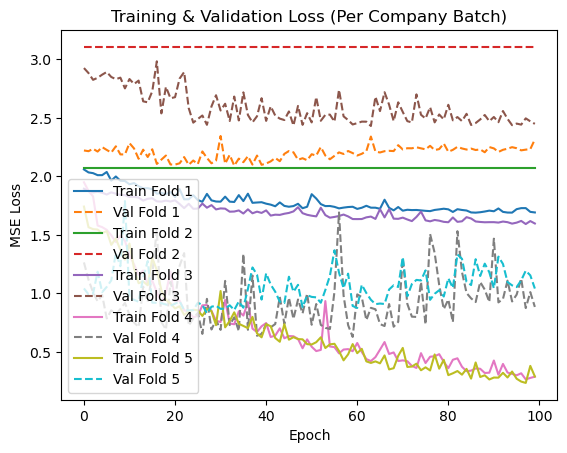

In [9]:
# --- Training Config ---
epochs = 100
learning_rate = 1e-3

all_train_losses = []
all_val_losses = []

for fold_id, (train_coms, test_coms) in enumerate(folds):
    print(f"\n====== Fold {fold_id+1} ======")
    
    # Dataset   
    train_dataset = SlidingWindowDatasetMax5(df, train_coms)
    test_dataset = SlidingWindowDatasetMax5(df, test_coms)

    # Sampler
    train_sampler = CompanyBatchSampler(train_dataset)
    val_sampler = CompanyBatchSampler(test_dataset)

    # DataLoader
    train_loader = DataLoader(train_dataset, batch_sampler=train_sampler, collate_fn=lambda x: x)
    val_loader = DataLoader(test_dataset, batch_sampler=val_sampler, collate_fn=lambda x: x)

    model = LSTM_MTL_Stepwise().to(device)
    optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
    criterion = nn.MSELoss()

    train_loss_list = []
    val_loss_list = []

    for epoch in range(epochs):
        model.train()
        epoch_losses = []
        for batch in train_loader:
            x_seqs, y_seqs, tickers, y_years, indices = zip(*batch)
            lengths = torch.tensor([x.shape[0] for x in x_seqs]).to(device)
            x_seqs = pad_sequence(x_seqs, batch_first=True).to(device)
            y_seqs = torch.stack(y_seqs).to(device)

            preds = model(x_seqs, lengths)

            # ✅ 計算 sample_weights
            sample_weights = torch.where(y_seqs.sum(dim=1) == 0, torch.zeros_like(y_seqs[:, 0]), torch.ones_like(y_seqs[:, 0]))


            # loss = criterion(preds, y_seqs)
            # optimizer.zero_grad()
            # loss.backward()
            # optimizer.step()

            # epoch_losses.append(loss.item())
                # ✅ 逐樣本 loss
            losses = criterion(preds, y_seqs)  # [B, 2]
            losses = losses.mean(dim=-1)       # [B]，讓每個樣本只有一個 loss
            weighted_loss = (losses * sample_weights).sum() / (sample_weights.sum() + 1e-8)

            optimizer.zero_grad()
            weighted_loss.backward()
            optimizer.step()

            epoch_losses.append(weighted_loss.item())

            # ✔ 每個 batch 印 loss、predictions、truth
            print(f"[Fold {fold_id+1}][Epoch {epoch+1}][Train] Company: {tickers[0]} | Samples: {len(indices)} | Loss: {weighted_loss.item():.4f}")
            print(f"  Predictions (expm1, round): {np.round(torch.expm1(preds).detach().cpu().numpy())}")
            print(f"  Ground truth (expm1, round): {np.round(torch.expm1(y_seqs).detach().cpu().numpy())}")
            print(f"  Indices: {indices}")

        avg_train_loss = np.mean(epoch_losses)
        train_loss_list.append(avg_train_loss)

        # Validation
        model.eval()
        with torch.no_grad():
            val_losses = []
            all_preds = []
            all_y = []
            for batch in val_loader:
                x_seqs, y_seqs, tickers, y_years, indices = zip(*batch)
                lengths = torch.tensor([x.shape[0] for x in x_seqs]).to(device)
                x_seqs = pad_sequence(x_seqs, batch_first=True).to(device)
                y_seqs = torch.stack(y_seqs).to(device)

                preds = model(x_seqs, lengths)
                
                # 加入 sample weight
                sample_weights = torch.ones_like(y_seqs[:, 0])  # [B]
                mask = (y_seqs.sum(dim=1) == 0)
                sample_weights[mask] = 0  # 只要 y 兩個值都 0，就權重 0

                # loss = criterion(preds, y_seqs)
                # val_losses.append(loss.item())

                losses = criterion(preds, y_seqs).mean(dim=-1)   # [B]
                weighted_loss = (losses * sample_weights).sum() / (sample_weights.sum() + 1e-8)
                
                val_losses.append(weighted_loss.item())                

                all_preds.append(preds)
                all_y.append(y_seqs)

                # ✔ 每個 batch 印 loss、predictions、truth
                print(f"[Fold {fold_id+1}][Epoch {epoch+1}][Val] Company: {tickers[0]} | Samples: {len(indices)} | Loss: {weighted_loss.item():.4f}")
                print(f"  Predictions (expm1, rounded): {np.round(torch.expm1(preds).detach().cpu().numpy())}")
                print(f"  Ground truth (expm1): {torch.expm1(y_seqs).detach().cpu().numpy()}")
                print(f"  Indices: {indices}")

            avg_val_loss = np.mean(val_losses)
            val_loss_list.append(avg_val_loss)

            all_preds = torch.cat(all_preds)
            all_y = torch.cat(all_y)

            # ✔ 每個 epoch 最後 summary
            print(f"[Fold {fold_id+1}][Epoch {epoch+1}] Train Avg Loss: {avg_train_loss:.4f} | Val Avg Loss: {avg_val_loss:.4f}")

            metrics = compute_metrics(all_preds, all_y)
            for name, vals in metrics.items():
                print(f"{name} Metrics: {vals}")


    all_train_losses.append(train_loss_list)
    all_val_losses.append(val_loss_list)

# --- Plot Learning Curves ---
plt.figure()
for fold_id in range(5):
    plt.plot(all_train_losses[fold_id], label=f"Train Fold {fold_id+1}")
    plt.plot(all_val_losses[fold_id], label=f"Val Fold {fold_id+1}", linestyle='--')
plt.xlabel("Epoch")
plt.ylabel("MSE Loss")
plt.title("Training & Validation Loss (Per Company Batch)")
plt.legend()
plt.show()

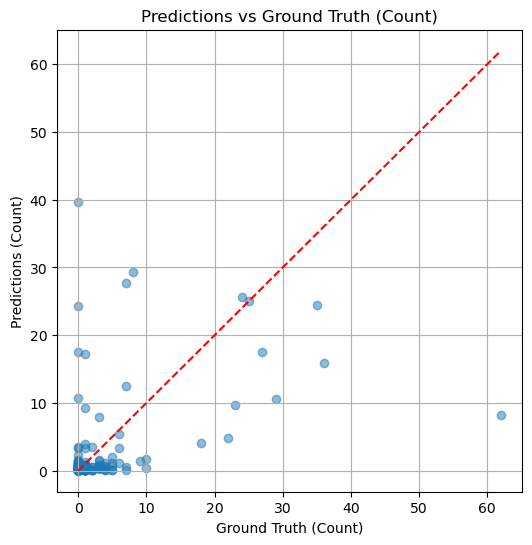

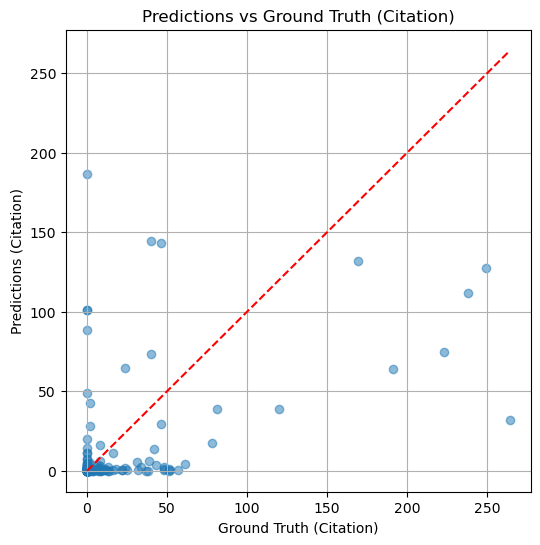

In [10]:
import matplotlib.pyplot as plt
import numpy as np

# 假設 all_preds 與 all_y 已經是 numpy 格式（expm1 過）
# 如果還是 torch.Tensor，你可以先轉
y_pred_plot = np.expm1(all_preds.cpu().numpy()) if hasattr(all_preds, 'cpu') else np.expm1(all_preds)
y_true_plot = np.expm1(all_y.cpu().numpy()) if hasattr(all_y, 'cpu') else np.expm1(all_y)

# 畫 count (第 0 維)
plt.figure(figsize=(6, 6))
plt.scatter(y_true_plot[:, 0], y_pred_plot[:, 0], alpha=0.5)
plt.plot([y_true_plot[:, 0].min(), y_true_plot[:, 0].max()], 
         [y_true_plot[:, 0].min(), y_true_plot[:, 0].max()], 'r--')
plt.xlabel("Ground Truth (Count)")
plt.ylabel("Predictions (Count)")
plt.title("Predictions vs Ground Truth (Count)")
plt.grid(True)
plt.show()

# 畫 citation (第 1 維)
plt.figure(figsize=(6, 6))
plt.scatter(y_true_plot[:, 1], y_pred_plot[:, 1], alpha=0.5)
plt.plot([y_true_plot[:, 1].min(), y_true_plot[:, 1].max()], 
         [y_true_plot[:, 1].min(), y_true_plot[:, 1].max()], 'r--')
plt.xlabel("Ground Truth (Citation)")
plt.ylabel("Predictions (Citation)")
plt.title("Predictions vs Ground Truth (Citation)")
plt.grid(True)
plt.show()
